<a href="https://colab.research.google.com/github/evanmahmud/World-Cup-2023-Analysis/blob/main/World_Cup_2023_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     - 17.8 MB 23.5 MB/s 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 2.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 293.3/293.3 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 10.2 MB/s eta 0:00:00
  Created wheel for ydata-profiling: filename=ydata_profiling-0.0.dev0-py2.py3-none-any.whl size=357942 sha256=db28f60c9aeef4cd51196039925886225cdb346d59b99b4a86e7070102483c03
  Stored in directory: /tmp/pip-ephem-wheel-cache-sdy0f7i7/wheels/07/29/61/f533cc7cbd0a97efb2d1b94d3254a3e859a949367ba842577b
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=d3c1872d77d0695dd673d6daf18c497500a03c83cd45bbca68d1649b94f7758d
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec

In [2]:
import pandas as pd
df = pd.read_csv('https://raw.githubusercontent.com/evanmahmud/World-Cup-2023-Analysis/main/CWC23_all_innings.csv')
df.head()

,team,player,bat_or_bowl,bb_bf,runs,wkts,wicketball_prob,runs_per_ball,opposition,ground,start_date,overs,mdns,econ,inns,4s,6s,sr,not_out,mins
0,PAK,Shaheen Shah Afridi (PAK),bowl,60,45,3.0,0.05,0.750000,v South Africa,Chennai,27-Oct-23,10.0,0.0,4.5,2,NaN,NaN,NaN,NaN,NaN
1,ENG,DJ Willey (ENG),bowl,60,45,3.0,0.05,0.750000,v India,Lucknow,29-Oct-23,10.0,2.0,4.5,1,NaN,NaN,NaN,NaN,NaN
2,NZ,MJ Henry (NZ),bowl,60,48,3.0,0.05,0.800000,v England,Ahmedabad,5-Oct-23,10.0,1.0,4.8,1,NaN,NaN,NaN,NaN,NaN
3,NZ,LH Ferguson (NZ),bowl,60,49,3.0,0.05,0.816667,v Bangladesh,Chennai,13-Oct-23,10.0,0.0,4.9,1,NaN,NaN,NaN,NaN,NaN
4,AFG,Noor Ahmad (AFG),bowl,60,49,3.0,0.05,0.816667,v Pakistan,Chennai,23-Oct-23,10.0,0.0,4.9,1,NaN,NaN,NaN,NaN,NaN


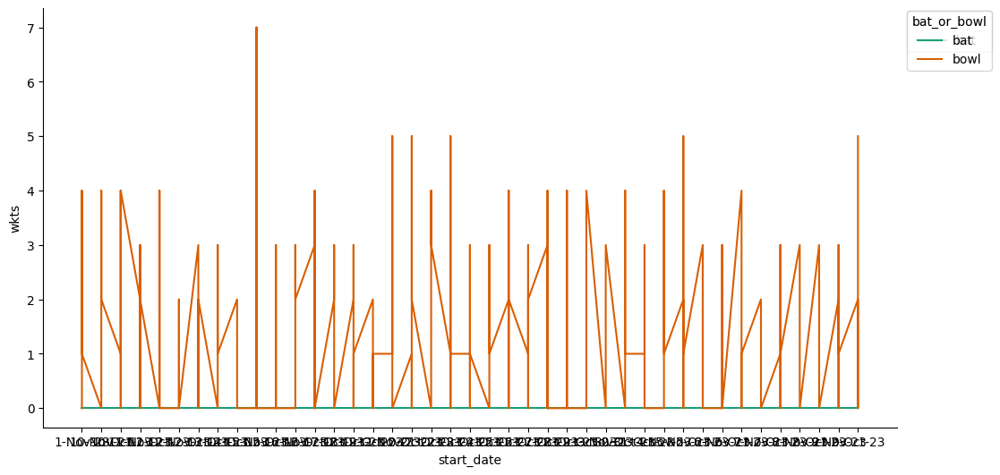

In [28]:
# @title start_date vs wkts

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['start_date']
  ys = series['wkts']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('start_date', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('bat_or_bowl')):
  _plot_series(series, series_name, i)
  fig.legend(title='bat_or_bowl', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('start_date')
_ = plt.ylabel('wkts')

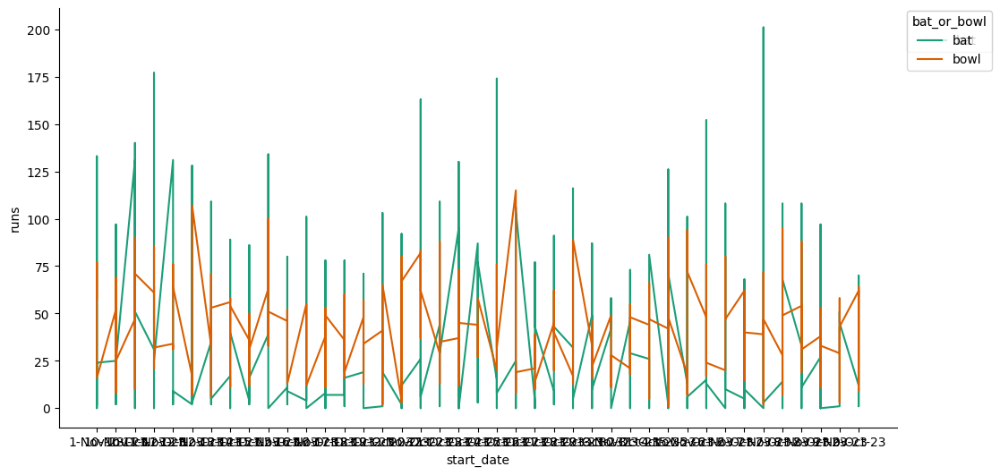

In [27]:
# @title start_date vs runs

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['start_date']
  ys = series['runs']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('start_date', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('bat_or_bowl')):
  _plot_series(series, series_name, i)
  fig.legend(title='bat_or_bowl', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('start_date')
_ = plt.ylabel('runs')

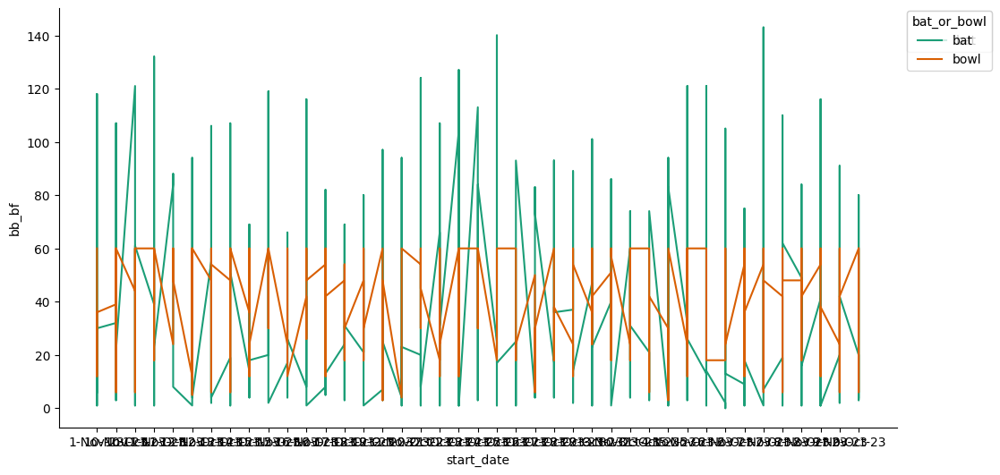

In [26]:
# @title start_date vs bb_bf

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['start_date']
  ys = series['bb_bf']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('start_date', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('bat_or_bowl')):
  _plot_series(series, series_name, i)
  fig.legend(title='bat_or_bowl', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('start_date')
_ = plt.ylabel('bb_bf')

In [3]:
df.fillna(0, inplace=True)

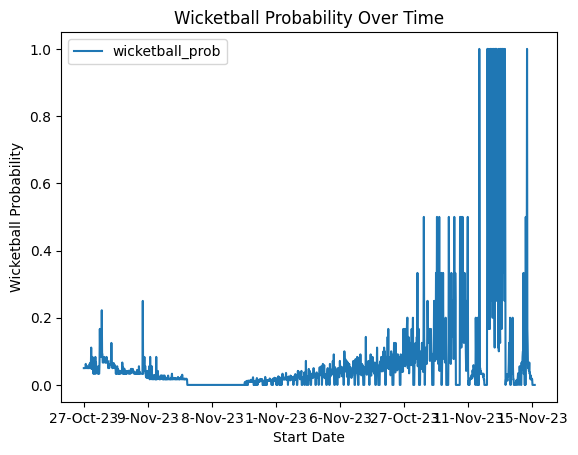

In [4]:
# @title Wicketball Probability Over Time

import matplotlib.pyplot as plt

df.plot.line(x='start_date', y='wicketball_prob')
plt.xlabel('Start Date')
plt.ylabel('Wicketball Probability')
_ = plt.title('Wicketball Probability Over Time')

Text(0, 0.5, 'bb_bf')

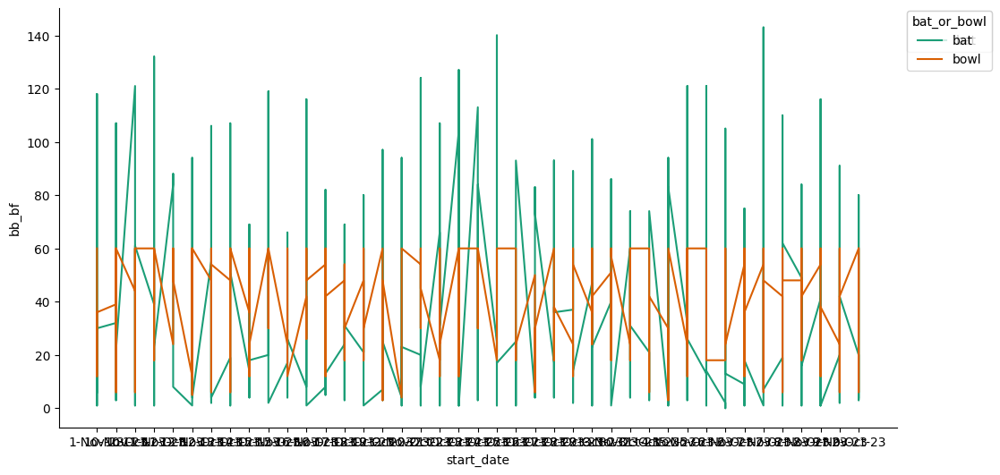

In [5]:
# @title start_date vs bb_bf

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['start_date']
  ys = series['bb_bf']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('start_date', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('bat_or_bowl')):
  _plot_series(series, series_name, i)
  fig.legend(title='bat_or_bowl', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('start_date')
plt.ylabel('bb_bf')

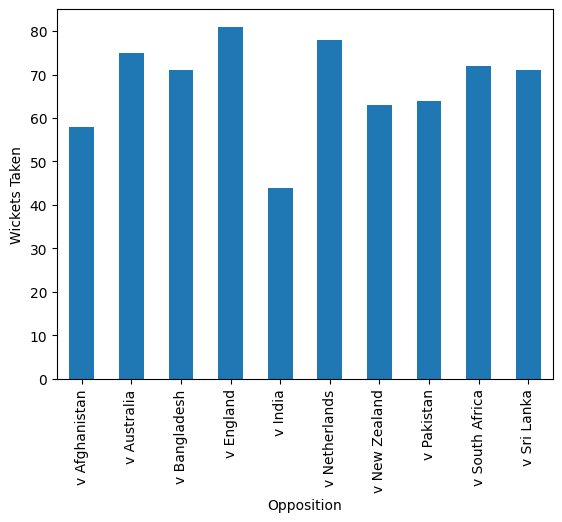

In [6]:
# @title Wickets Taken vs Opposition

import matplotlib.pyplot as plt
df.groupby('opposition')['wkts'].sum().plot(kind='bar')
plt.xlabel('Opposition')
_ = plt.ylabel('Wickets Taken')

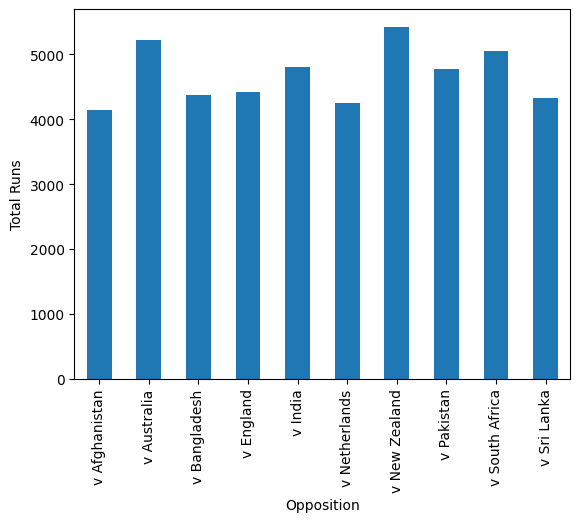

In [29]:
# @title Wickets Taken vs Opposition

import matplotlib.pyplot as plt
df.groupby('opposition')['runs'].sum().plot(kind='bar')
plt.xlabel('Opposition')
_ = plt.ylabel('Total Runs')

<Figure size 1000x2000 with 0 Axes>

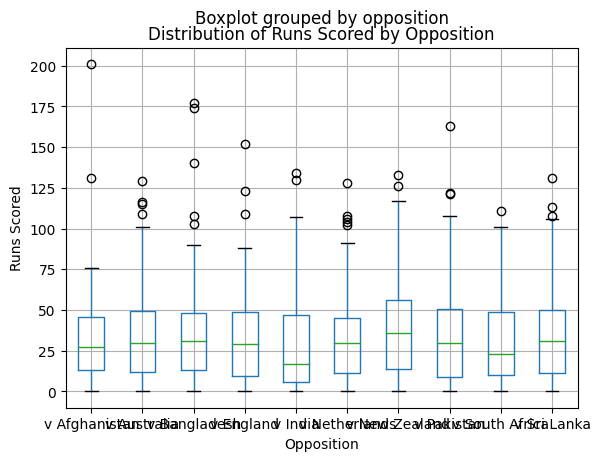

<Figure size 1000x2000 with 0 Axes>

In [7]:
# @title Distribution of Runs Scored by Opposition

import matplotlib.pyplot as plt
df.boxplot(column='runs', by='opposition')
plt.xlabel('Opposition')
plt.ylabel('Runs Scored')
plt.title('Distribution of Runs Scored by Opposition')
plt.figure(figsize = (10,20))

<Axes: xlabel='team'>

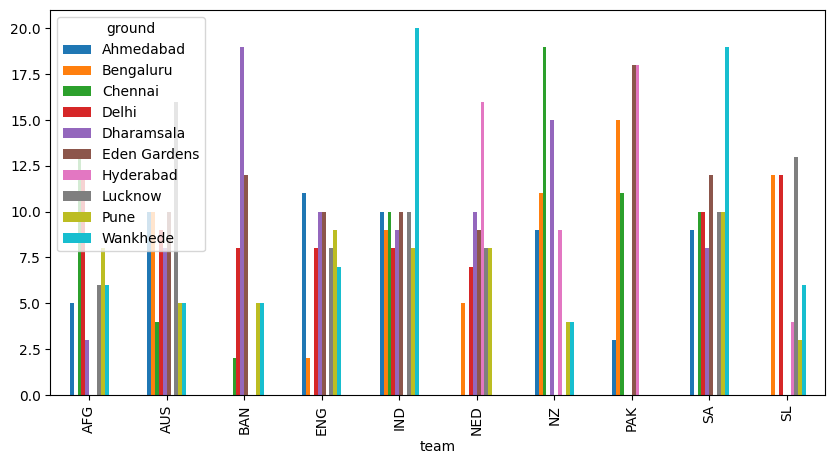

In [8]:
# @title Wickets Taken by Teams Across Grounds

df.groupby(['team', 'ground'])['wkts'].sum().unstack().plot(kind='bar', figsize=(10, 5))

wkts  player                   
0.0   A Dutt (NED)                 Axes(0.125,0.11;0.775x0.77)
      A Zampa (AUS)                Axes(0.125,0.11;0.775x0.77)
      AAP Atkinson (ENG)           Axes(0.125,0.11;0.775x0.77)
      AD Mathews (SL)              Axes(0.125,0.11;0.775x0.77)
      AK Markram (SA)              Axes(0.125,0.11;0.775x0.77)
                                              ...             
5.0   MJ Santner (NZ)              Axes(0.125,0.11;0.775x0.77)
      Mohammed Shami (IND)         Axes(0.125,0.11;0.775x0.77)
      RA Jadeja (IND)              Axes(0.125,0.11;0.775x0.77)
      Shaheen Shah Afridi (PAK)    Axes(0.125,0.11;0.775x0.77)
7.0   Mohammed Shami (IND)         Axes(0.125,0.11;0.775x0.77)
Name: runs, Length: 339, dtype: object

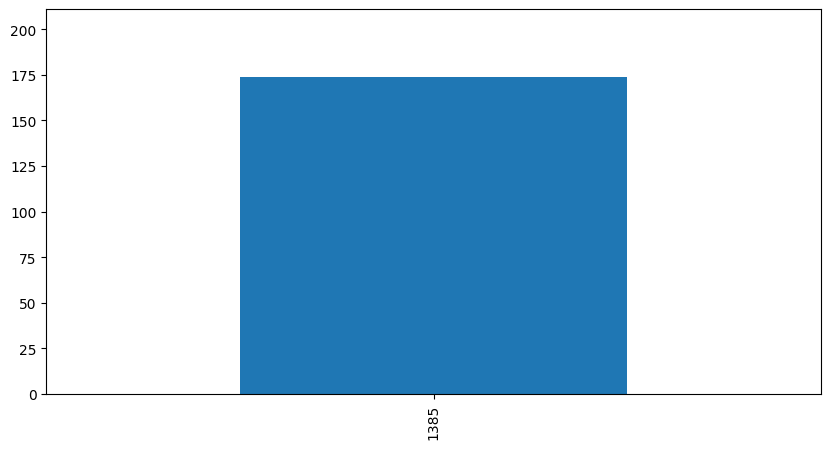

In [19]:
df.groupby(['wkts', 'player'])['runs'].plot(kind='bar', figsize=(10, 5))

<Axes: xlabel='team'>

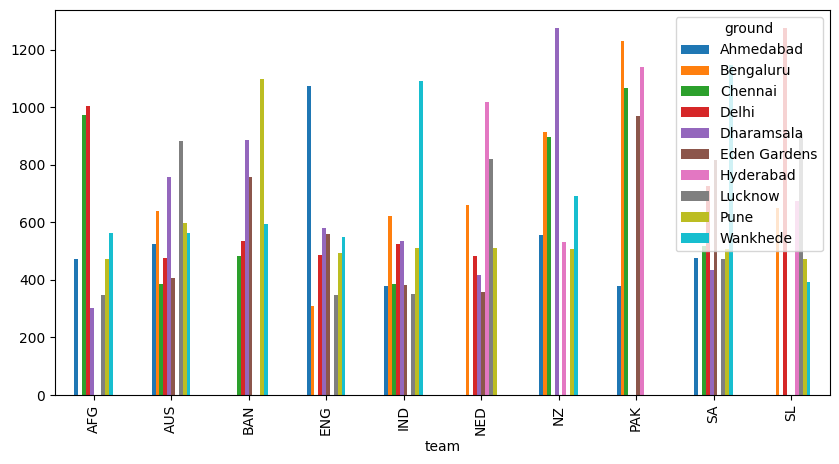

In [12]:
# @title Wickets Taken by Teams Across Grounds

df.groupby(['team', 'ground'])['runs'].sum().unstack().plot(kind='bar', figsize=(10, 5))

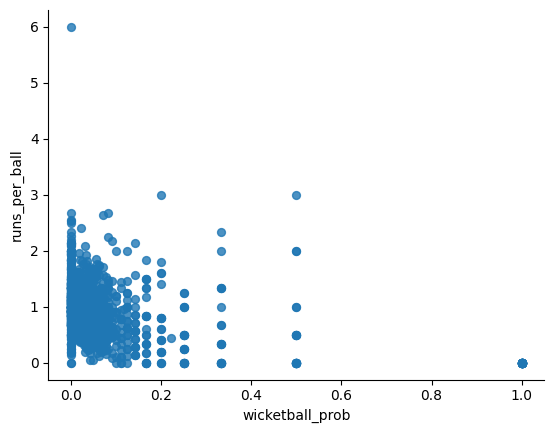

In [9]:
# @title wicketball_prob vs runs_per_ball

from matplotlib import pyplot as plt
df.plot(kind='scatter', x='wicketball_prob', y='runs_per_ball', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

In [10]:
import pandas_profiling as pp
profile = df.profile_report(title = 'World Cup 2023')
profile

<ipython-input-10-bb6d6d038ae6>:1: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  import pandas_profiling as pp


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
df.head()

,team,player,bat_or_bowl,bb_bf,runs,wkts,wicketball_prob,runs_per_ball,opposition,ground,start_date,overs,mdns,econ,inns,4s,6s,sr,not_out,mins
0,PAK,Shaheen Shah Afridi (PAK),bowl,60,45,3.0,0.05,0.750000,v South Africa,Chennai,27-Oct-23,10.0,0.0,4.5,2,0.0,0.0,0.0,0.0,0.0
1,ENG,DJ Willey (ENG),bowl,60,45,3.0,0.05,0.750000,v India,Lucknow,29-Oct-23,10.0,2.0,4.5,1,0.0,0.0,0.0,0.0,0.0
2,NZ,MJ Henry (NZ),bowl,60,48,3.0,0.05,0.800000,v England,Ahmedabad,5-Oct-23,10.0,1.0,4.8,1,0.0,0.0,0.0,0.0,0.0
3,NZ,LH Ferguson (NZ),bowl,60,49,3.0,0.05,0.816667,v Bangladesh,Chennai,13-Oct-23,10.0,0.0,4.9,1,0.0,0.0,0.0,0.0,0.0
4,AFG,Noor Ahmad (AFG),bowl,60,49,3.0,0.05,0.816667,v Pakistan,Chennai,23-Oct-23,10.0,0.0,4.9,1,0.0,0.0,0.0,0.0,0.0


/usr/local/lib/python3.10/dist-packages/pandas/plotting/_matplotlib/core.py:509: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


runs  player            
0     A Zampa (AUS)         Axes(0.125,0.11;0.775x0.77)
      AAP Atkinson (ENG)    Axes(0.125,0.11;0.775x0.77)
      AD Mathews (SL)       Axes(0.125,0.11;0.775x0.77)
      AT Carey (AUS)        Axes(0.125,0.11;0.775x0.77)
      AU Rashid (ENG)       Axes(0.125,0.11;0.775x0.77)
                                       ...             
152   DP Conway (NZ)        Axes(0.125,0.11;0.775x0.77)
163   DA Warner (AUS)       Axes(0.125,0.11;0.775x0.77)
174   Q de Kock (SA)        Axes(0.125,0.11;0.775x0.77)
177   MR Marsh (AUS)        Axes(0.125,0.11;0.775x0.77)
201   GJ Maxwell (AUS)      Axes(0.125,0.11;0.775x0.77)
Length: 1312, dtype: object

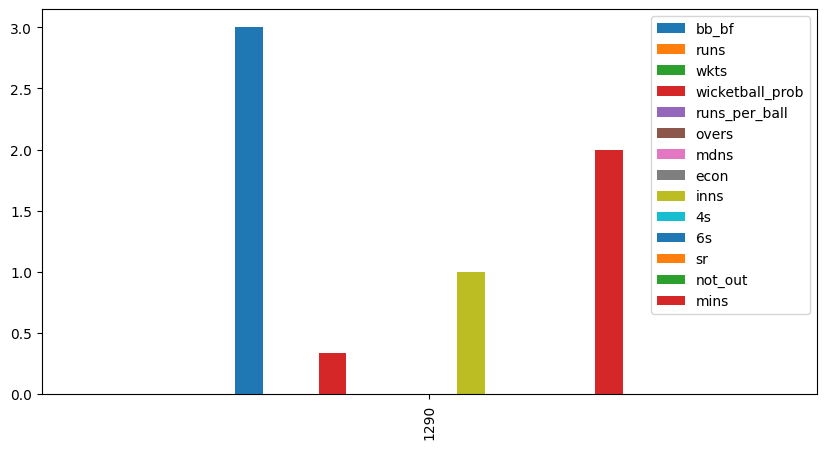

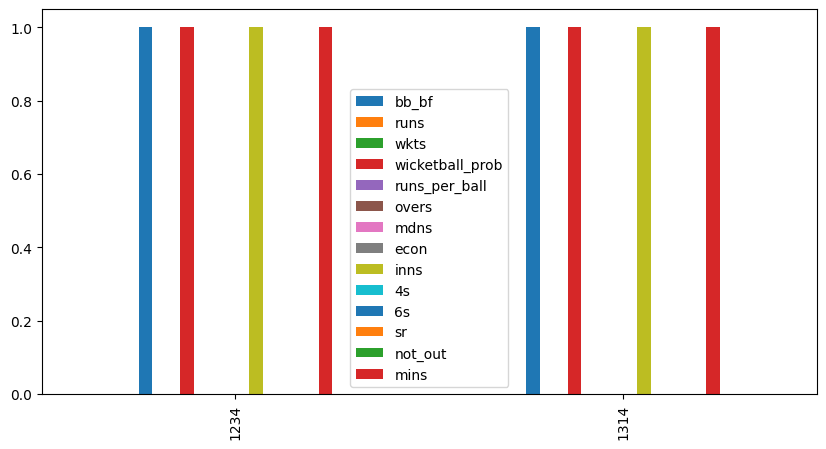

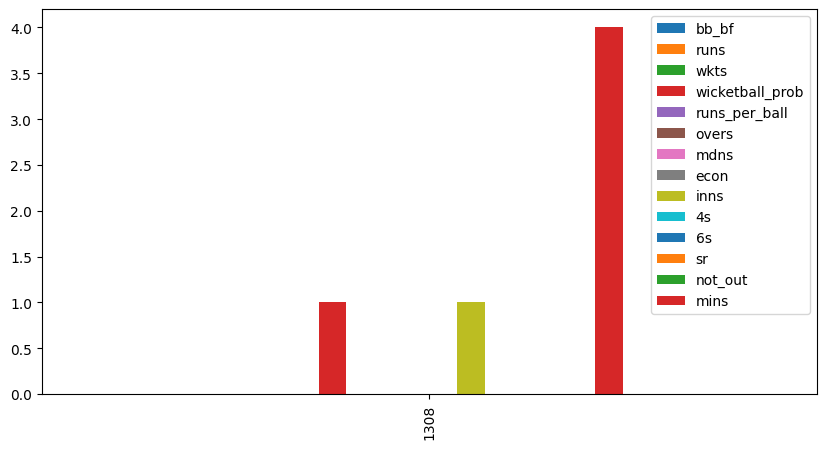

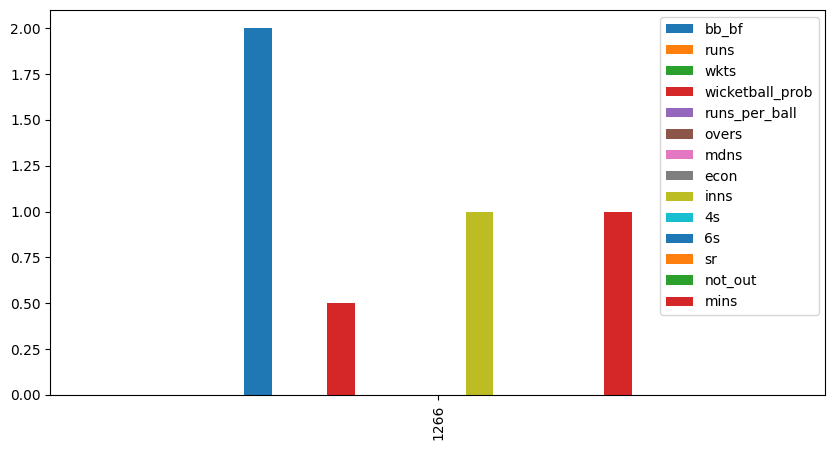

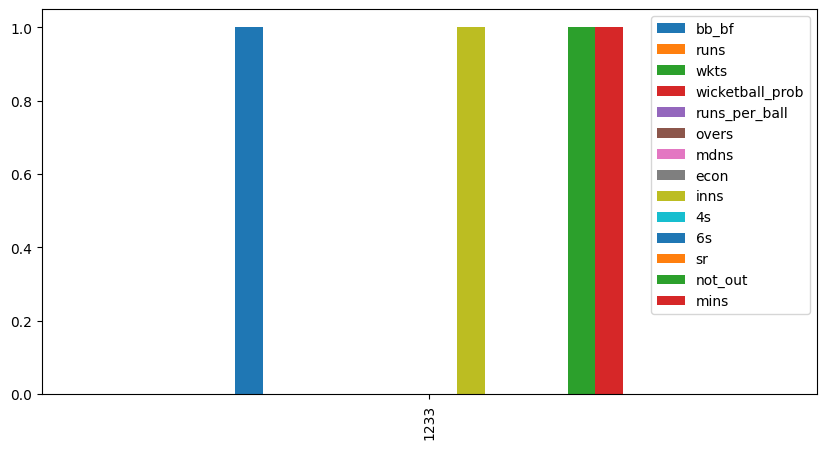

...

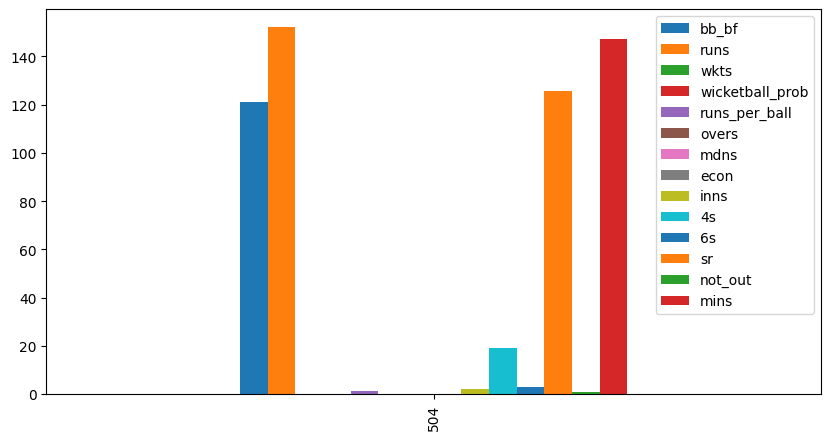

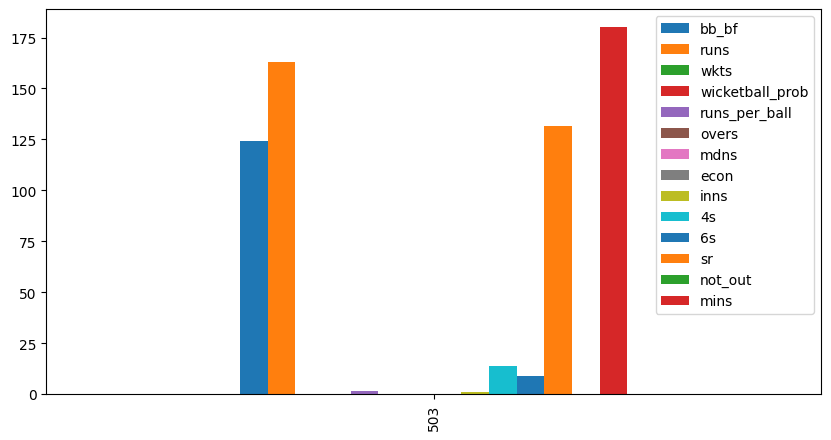

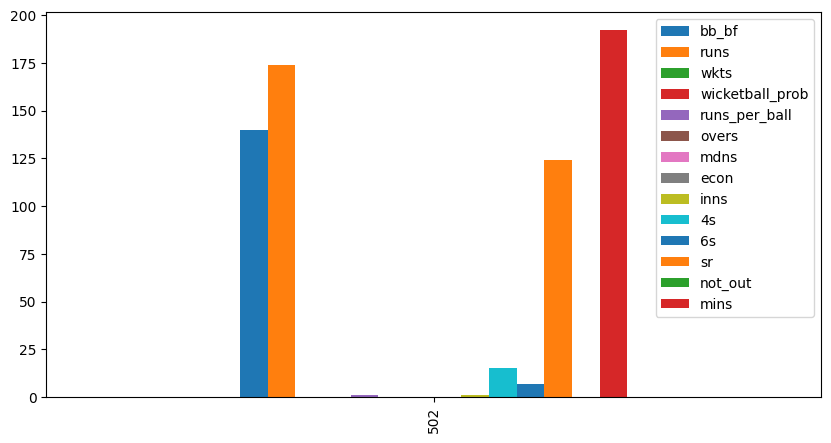

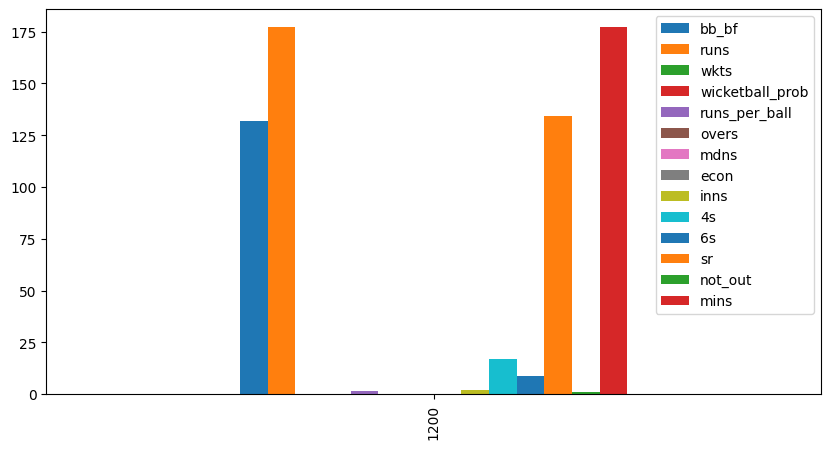

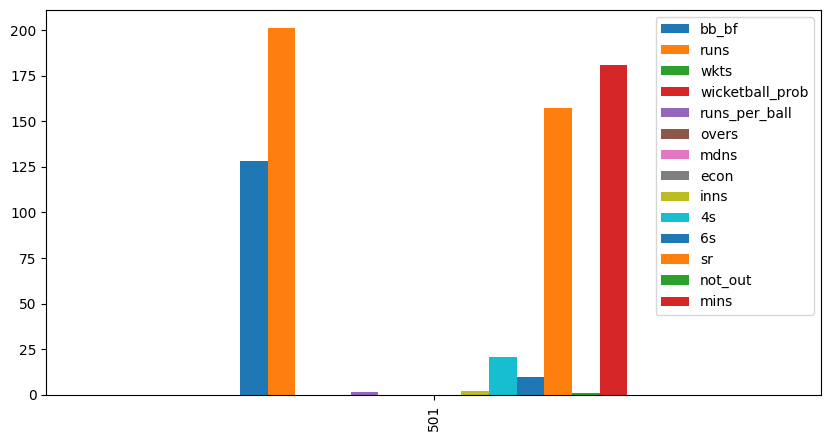

In [25]:
df.groupby(['runs', 'player']).plot(kind='bar', figsize=(10, 5))